In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly import tools
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()   
from plotly.offline import plot, iplot, init_notebook_mode
import geopy
from geopy.geocoders import Nominatim
import folium
from folium.plugins import HeatMap
init_notebook_mode(connected=True)
pd.set_option('precision',0)
import warnings
warnings.filterwarnings('ignore')



In [2]:
table = pd.read_csv('G:/SEMESTER_6/coviddatasetfile.csv',usecols = ['id','date','administrative_area_level_1','confirmed','deaths','recovered','tests'],parse_dates=['date'])
#table=table.fillna(0)
pd.set_option('display.max_rows', table.shape[0]) 
pd.set_option('display.max_columns', None)

table.style.set_properties(subset=['ad_description'], **{'width-max': '100px'})
table[163212:163220].style.background_gradient(cmap='cool')

,id,date,confirmed,deaths,recovered,tests,administrative_area_level_1
163212,c39bfe6c,2020-04-19 00:00:00,17615,559,2854,401586,India
163213,c39bfe6c,2020-04-20 00:00:00,18539,592,3273,0,India
163214,c39bfe6c,2020-04-21 00:00:00,20080,645,3975,462621,India
163215,c39bfe6c,2020-04-22 00:00:00,21370,681,4370,0,India
163216,c39bfe6c,2020-04-23 00:00:00,23077,721,5012,500542,India
163217,c39bfe6c,2020-04-24 00:00:00,24530,780,5498,541789,India
163218,c39bfe6c,2020-04-25 00:00:00,26283,825,5939,579957,India
163219,c39bfe6c,2020-04-26 00:00:00,27890,881,6523,625309,India


In [3]:
df = pd.read_csv("D:/WHO-COVID-19-global-data.csv", index_col='Date_reported', parse_dates=True,encoding="latin-1")

In [4]:
df.head()

,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
Date_reported,,,,,,,
2020-03-01,AF,Afghanistan,EMRO,0,0,0,0
2020-04-01,AF,Afghanistan,EMRO,0,0,0,0
2020-05-01,AF,Afghanistan,EMRO,0,0,0,0
2020-06-01,AF,Afghanistan,EMRO,0,0,0,0
2020-07-01,AF,Afghanistan,EMRO,0,0,0,0


In [ ]:
# 7 may 

In [6]:
#df = pd.read_csv('G:/SEMESTER_6/coviddatasetfile.csv',index_col='date', parse_dates=True)
#df.head()
#df.rename(columns={'ObservationDate':'Date', 'Country/Region':'Country'}, inplace=True)
cols = ['date','confirmed','deaths','recovered','administrative_area_level_1']

pd.read_csv('G:/SEMESTER_6/coviddatasetfile.csv', usecols=cols).to_csv('G:/SEMESTER_6/updatedcoviddatasetfile.csv', index=False)

In [7]:
df2 = pd.read_csv('G:/SEMESTER_6/updatedcoviddatasetfile.csv')
df2.rename(columns={'date':'Date', 'administrative_area_level_1':'Country','confirmed':'Confirmed','deaths':'Death','recovered':'Recovered'}, inplace=True)

In [8]:
df2.head()

,Date,Confirmed,Death,Recovered,Country
0,13-03-20,2,0,0,Grand Princess
1,14-03-20,2,0,0,Grand Princess
2,15-03-20,2,0,0,Grand Princess
3,16-03-20,2,0,0,Grand Princess
4,17-03-20,8,0,0,Grand Princess


In [9]:
df = df[['New_cases']]


In [10]:
df.columns = ['cases']
df.head()

,cases
Date_reported,
2020-03-01,0
2020-04-01,0
2020-05-01,0
2020-06-01,0
2020-07-01,0


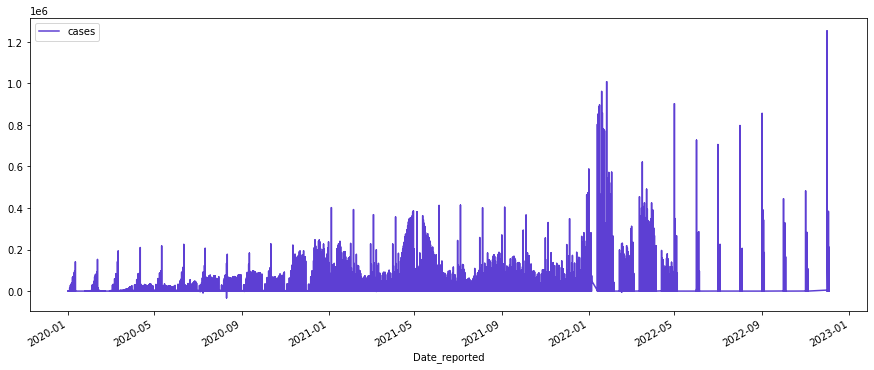

In [11]:
df.plot(color='#5D3FD3', figsize=(15,6));

In [12]:
table['administrative_area_level_1'].value_counts().head(10)

Argentina        843
Mexico           843
Thailand         841
China            841
Taiwan           830
Latvia           825
Greece           824
Estonia          824
United States    823
Japan            823
Name: administrative_area_level_1, dtype: int64

In [13]:
table.isnull().sum()

id                             0
date                           0
confirmed                      0
deaths                         0
recovered                      0
tests                          0
administrative_area_level_1    0
dtype: int64

In [7]:
cases = ['confirmed', 'deaths', 'recovered', 'active']
table['active'] = table['confirmed'] - table['deaths'] - table['recovered']
#table[['Province/State']] = table[['Province/State']].fillna('')
table[cases] = table[cases].fillna(0)
latest = table[table['date'] == max(table['date'])].reset_index()

latest_grouped = latest['confirmed'] - latest['deaths'] - latest['recovered']
latest_grouped = latest.groupby('administrative_area_level_1')['confirmed', 'deaths', 'active'].sum().reset_index()

pred = latest_grouped.sort_values(by='confirmed', ascending=False)
pred = pred.reset_index(drop=True)
cm = sns.light_palette("red", as_cmap=True)
datas = pred.head(11).style.background_gradient(cmap=cm).background_gradient(cmap='Blues',subset=["active"]).background_gradient(cmap='Oranges',subset=["confirmed"])

In [8]:
type(datas)
import dataframe_image as dfi

dfi.export(datas, 'df_styled.png')

In [9]:
temp = table.groupby('date')['confirmed', 'deaths', 'recovered', 'active'].sum().reset_index()
temp = temp.sort_values('date', ascending=False)
cm = sns.light_palette("red", as_cmap=True)
temp.head(11).style.background_gradient(cmap=cm).background_gradient(cmap='Greens',subset=["recovered"]).background_gradient(cmap='Blues',subset=["active"]).background_gradient(cmap='Oranges',subset=["confirmed"])

,date,confirmed,deaths,recovered,active
843,2022-12-04 00:00:00,489469261,5834948,89641173,393993140
842,2022-12-03 00:00:00,446106573,5689971,80281035,360135567
841,2022-12-02 00:00:00,400404626,5469401,65791936,329143289
840,2022-12-01 00:00:00,313453780,5399620,52564802,255489358
839,2022-11-04 00:00:00,484690614,5809259,89472998,389408357
838,2022-11-03 00:00:00,444322447,5684709,82839157,355798581
837,2022-11-02 00:00:00,398585045,5460916,65295984,327828145
836,2022-11-01 00:00:00,310159961,5391061,52185881,252583019
835,2022-10-04 00:00:00,483882329,5806616,89343663,388732050
834,2022-10-03 00:00:00,443436827,5685269,80661793,357089765


In [10]:
total_count = pd.DataFrame({'Category':'deaths', 'Count':temp.head(1)['deaths']})
total_count = total_count.append({'Category':'recovered','Count':int(temp.head(1)['recovered'])}, ignore_index=True)
total_count = total_count.append({'Category':"confirmed",'Count':int(temp.head(1)['confirmed'])}, ignore_index=True)
total_count = total_count.append({'Category':"active",'Count':int(temp.head(1)['active'])}, ignore_index=True)
fig = px.bar(total_count, x='Count', y='Category',
             hover_data=['Count'], color='Count',
             labels={}, orientation='h',height=400, width = 650)
fig.update_layout(title_text='Confirmed vs Recovered vs Death cases vs Active')
fig.show()


In [21]:
fig.write_image("fig1.png")

ValueError: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


In [20]:
figure.show()

In [45]:


df = pd.read_csv('G:/SEMESTER_6/coviddatasetfile.csv',usecols = ['id','date','administrative_area_level_1','confirmed','deaths','recovered'])
df.head()



,id,date,confirmed,deaths,recovered,administrative_area_level_1
0,8320791a,13-03-20,2,0,0,Grand Princess
1,8320791a,14-03-20,2,0,0,Grand Princess
2,8320791a,15-03-20,2,0,0,Grand Princess
3,8320791a,16-03-20,2,0,0,Grand Princess
4,8320791a,17-03-20,8,0,0,Grand Princess


In [46]:

df1=df.copy()
df1=df1.groupby('administrative_area_level_1').max()
df1.style.background_gradient(cmap='RdPu')


,id,date,confirmed,deaths,recovered
administrative_area_level_1,,,,,
Afghanistan,9c587466,31-12-21,178638,7680,82586
Albania,16dd6863,31-12-21,274737,3496,130314
Algeria,95874ee5,31-12-21,265761,6874,118409
American Samoa,4b387b6c,31-12-21,5517,12,0
Andorra,cd88afd4,31-12-21,41013,155,14380
Angola,8b98cd15,31-12-21,99287,1900,39582
Anguilla,f2a3cd9c,31-12-21,2731,9,111
Antigua and Barbuda,e4ac04b5,31-12-21,7571,135,1239
Argentina,b2f6a333,31-12-21,9060923,128344,4615834


In [47]:
fig = px.choropleth(df1, locations=df1.index,locationmode='country names', color='confirmed',
                           color_continuous_scale="Purpor"
                          )
fig.update_layout(title="Total confirmed cases in the world",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )

fig.show()

In [48]:
fig = px.choropleth(df1, locations=df1.index,locationmode='country names', color='recovered',
                           color_continuous_scale="Purpor"
                          )
fig.update_layout(title="Total recovered cases in the world ",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()


In [49]:
fig = px.choropleth(df,locations='administrative_area_level_1',locationmode='country names',color='deaths',animation_frame='date',
                           color_continuous_scale="Purpor"
                          )
fig.update_layout(title="[Animation]-Total deaths due to Covid in world till now",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()

In [50]:
fig = px.choropleth(df,locations='administrative_area_level_1',locationmode='country names',color='recovered',animation_frame='date',
                           color_continuous_scale="Purpor"
                          )
fig.update_layout(title="[Animation]-Total recovered cases in world till now",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()

In [51]:

fig = px.choropleth(df,locations='administrative_area_level_1',locationmode='country names',color='confirmed',animation_frame='date',
                           color_continuous_scale="Purpor"
                          )
fig.update_layout(title="[Animation]-Total confirmed cases in world till now",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()




In [52]:

fig = px.choropleth(df1, locations=df1.index,locationmode='country names', color='recovered',
                           color_continuous_scale="Purpor",projection="orthographic"
                          )
fig.update_layout(title="Total recovered cases in Orthographic world view",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()


In [53]:

fig = px.choropleth(df1, locations=df1.index,locationmode='country names', color='deaths',
                           color_continuous_scale="Purpor",projection="orthographic"
                          )
fig.update_layout(title="Total deaths due to Covid in Orthographic world view",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()



In [54]:

fig = px.choropleth(df1, locations=df1.index,locationmode='country names', color='confirmed',
                           color_continuous_scale="Purpor",projection="orthographic"
                          )
fig.update_layout(title="Total confirmed cases in Orthographic world view",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()



In [55]:

fig = px.choropleth(df1, locations=df1.index,locationmode='country names', color='deaths',
                           color_continuous_scale="Purpor"
                          )
fig.update_layout(title="Total deaths due to Covid",
                  titlefont={'size': 20},
                  paper_bgcolor='lavenderblush'        
                  )
fig.show()